# Credit Card Customers Segmentation 

#### Importing Directories

In [1]:
import numpy as np
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
import plotly.io as pio
pio.templates.default = "plotly_white"

#### Data Exploration

In [29]:
# Importing Dataset

data = pd.read_csv("CreditCard.csv")
data

,Customer_ID,Age,Gender,Geography,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Payment_Behaviour,Monthly_Balance,Credit_Score,Credit_Score_,Status
0,44929,44,Male,India,Entrepreneur,57180.88,4584.073333,3,4,9,...,2,1126.79,41.831182,234,No,High_spent_Medium_value_payments,637.440888,Poor,0,Attrited
1,35586,27,Female,France,Accountant,108462.87,9313.572500,0,5,11,...,2,34.26,41.402949,211,No,High_spent_Large_value_payments,622.441031,Standard,1,Attrited
2,37586,20,Female,Geramany,Musician,99161.82,8055.485000,3,6,8,...,2,1159.42,35.749109,319,No,Low_spent_Small_value_payments,137.292162,Good,2,Attrited
3,16202,30,Male,France,Engineer,39418.47,3099.872500,5,4,1,...,2,517.87,26.868885,344,No,Low_spent_Small_value_payments,339.346132,Good,2,Attrited
4,42404,19,Female,France,Mechanic,135452.08,11212.673330,0,3,2,...,2,257.19,29.886524,245,No,High_spent_Medium_value_payments,1122.551482,Standard,1,Attrited
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24995,4007,35,Female,Scotland,Entrepreneur,123665.00,10145.416670,2,7,8,...,2,561.42,31.706989,285,NM,High_spent_Large_value_payments,714.541179,Standard,1,Existed
24996,29586,56,Male,Spain,Journalist,31226.77,2878.230833,5,7,11,...,2,1426.06,37.714017,262,No,Low_spent_Small_value_payments,447.933374,Poor,0,Attrited
24997,37011,29,Female,Scotland,Manager,38158.80,2992.900000,6,8,30,...,0,2678.85,31.318964,73,Yes,High_spent_Small_value_payments,145.733246,Poor,0,Attrited
24998,16510,36,Female,Geramany,Lawyer,22276.68,2014.390000,5,6,14,...,1,124.57,33.489738,254,No,High_spent_Large_value_payments,402.460063,Standard,1,Attrited


In [3]:
data.columns

Index(['Customer_ID', 'Age', 'Gender', 'Geography', 'Occupation',
       'Annual_Income', 'Monthly_Inhand_Salary', 'Num_Bank_Accounts',
       'Num_Credit_Card', 'Interest_Rate', 'Num_of_Loan', 'Type_of_Loan',
       'Delay_from_due_date', 'Num_of_Delayed_Payment', 'Credit_Mix',
       'Outstanding_Debt', 'Credit_Utilization_Ratio', 'Credit_History_Age',
       'Payment_of_Min_Amount', 'Payment_Behaviour', 'Monthly_Balance',
       'Credit_Score', 'Credit_Score_', 'Status'],
      dtype='object')

In [4]:
data.shape

(25000, 24)

In [5]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 25000 entries, 0 to 24999
Data columns (total 24 columns):
 #   Column                    Non-Null Count  Dtype  
---  ------                    --------------  -----  
 0   Customer_ID               25000 non-null  int64  
 1   Age                       25000 non-null  int64  
 2   Gender                    25000 non-null  object 
 3   Geography                 25000 non-null  object 
 4   Occupation                25000 non-null  object 
 5   Annual_Income             25000 non-null  float64
 6   Monthly_Inhand_Salary     25000 non-null  float64
 7   Num_Bank_Accounts         25000 non-null  int64  
 8   Num_Credit_Card           25000 non-null  int64  
 9   Interest_Rate             25000 non-null  int64  
 10  Num_of_Loan               25000 non-null  int64  
 11  Type_of_Loan              25000 non-null  object 
 12  Delay_from_due_date       25000 non-null  int64  
 13  Num_of_Delayed_Payment    25000 non-null  int64  
 14  Credit

In [6]:
data.describe()

,Customer_ID,Age,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Monthly_Balance,Credit_Score_
count,25000.000000,25000.000000,25000.000000,25000.000000,25000.000000,25000.000000,25000.000000,25000.000000,25000.000000,25000.000000,25000.000000,25000.000000,25000.000000,25000.000000,25000.000000,25000.000000
mean,26110.091320,33.331080,50347.684595,4183.739401,5.379920,5.535880,14.580640,3.540080,21.081720,13.333000,1.063080,1428.999186,32.303115,220.548880,392.681375,0.885400
std,14382.902183,10.737929,38347.294059,3190.331422,2.594704,2.073105,8.782179,2.454806,14.733137,6.230735,0.732067,1161.368293,5.122288,99.320359,202.618542,0.676317
min,1006.000000,14.000000,7005.930000,303.645417,0.000000,0.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.230000,20.719745,2.000000,0.088628,0.000000
25%,13746.000000,24.000000,19275.835000,1621.216666,3.000000,4.000000,7.000000,2.000000,10.000000,9.000000,1.000000,562.307500,28.047630,145.000000,267.508505,0.000000
50%,26067.000000,33.000000,36916.420000,3079.875833,6.000000,5.000000,13.000000,3.000000,18.000000,14.000000,1.000000,1163.930000,32.316272,218.000000,333.869100,1.000000
75%,38605.000000,42.000000,70939.340000,5902.424375,7.000000,7.000000,20.000000,5.000000,28.000000,18.000000,2.000000,1956.660000,36.520843,300.000000,461.126480,1.000000
max,50999.000000,56.000000,179987.280000,15204.633330,11.000000,11.000000,34.000000,9.000000,62.000000,25.000000,2.000000,4998.070000,49.522324,404.000000,1183.930696,2.000000


In [7]:
data.isnull().sum()

Customer_ID                 0
Age                         0
Gender                      0
Geography                   0
Occupation                  0
Annual_Income               0
Monthly_Inhand_Salary       0
Num_Bank_Accounts           0
Num_Credit_Card             0
Interest_Rate               0
Num_of_Loan                 0
Type_of_Loan                0
Delay_from_due_date         0
Num_of_Delayed_Payment      0
Credit_Mix                  0
Outstanding_Debt            0
Credit_Utilization_Ratio    0
Credit_History_Age          0
Payment_of_Min_Amount       0
Payment_Behaviour           0
Monthly_Balance             0
Credit_Score                0
Credit_Score_               0
Status                      0
dtype: int64

In [8]:
data["Payment_of_Min_Amount"].value_counts()

Yes    13108
No      8844
NM      3048
Name: Payment_of_Min_Amount, dtype: int64

In [9]:
data["Credit_Score"].value_counts()

Standard    13237
Poor         7314
Good         4449
Name: Credit_Score, dtype: int64

In [32]:
data["Geography"].value_counts()

France      5101
Spain       5065
India       5036
Geramany    4930
Scotland    4868
Name: Geography, dtype: int64

#### Data Visualizations 

In [36]:
# Exploring the Geography feature to know if the occupation of the person affects credit scores:

fig = px.box(data,
             x="Credit_Score",
             y="Geography",  
             color="Credit_Score", 
             title="Credit Scores Based on Geography", 
             color_discrete_map={'Poor':'red',
                                 'Standard':'yellow',
                                 'Good':"Green"})
fig.show()

##### Note: There’s no significant difference in the credit scores among the customers of different occupations.

In [10]:
# Exploring the occupation feature to know if the occupation of the person affects credit scores:

fig = px.box(data, 
             x="Occupation",  
             color="Credit_Score", 
             title="Credit Scores Based on Occupation", 
             color_discrete_map={'Poor':'red',
                                 'Standard':'yellow',
                                 'Good':"Green"})
fig.show()

##### Note: There’s no significant difference in the credit scores among the customers of different occupations.

In [11]:
# let’s explore impact of the Annual Income of the person's credit scores 

fig = px.box(data,
            x = "Credit_Score",
            y = "Annual_Income",
            color = "Credit_Score",
            title = "Credit Score based on Annual Income",
            color_discrete_map={'Poor':'red',
                                 'Standard':'yellow',
                               'Good':"green"})
                                 
fig.update_traces(quartilemethod="exclusive")
fig.show()

##### Note : The above visualization predicts that the credit score is proportional to the more you earn annually.

In [12]:
data["Type_of_Loan"].nunique()

5734

In [13]:
# Now let’s see how many loans you can take at a time for a good credit score:

fig = px.box(data, 
             x="Credit_Score", 
             y="Num_of_Loan", 
             color="Credit_Score", 
             title="Credit Scores Based on Number of Loans Taken by the Person",
             color_discrete_map={'Poor':'red',
                                 'Standard':'yellow',
                                 'Good':'green'})

fig.update_traces(quartilemethod="exclusive")
fig.show()

##### Note : To have a good credit score, people should not take more than 1 – 3 loans at a time. Having more than three loans at a time will negatively impact your credit scores.

In [14]:
# Now let’s see if having more bank accounts impacts credit scores or not:

fig = px.box(data, 
             x="Credit_Score", 
             y="Num_Bank_Accounts", 
             color="Credit_Score",
             title="Credit Scores Based on Number of Bank Accounts", 
             color_discrete_map={'Poor':'red',
                                 'Standard':'yellow',
                                 'Good':'green'})

fig.update_traces(quartilemethod="exclusive")
fig.show()

##### Maintaining more than five accounts is not good for having a good credit score. A person should have 3 – 5 bank accounts only. So having more bank accounts doesn’t positively impact credit scores.

In [15]:
# Now let’s see if having more credit cards impacts credit scores or not:

fig = px.box(data, 
             x="Credit_Score", 
             y="Num_Credit_Card", 
             color="Credit_Score",
             title="Credit Scores Based on Number of Credit Cards", 
             color_discrete_map={'Poor':'red',
                                 'Standard':'yellow',
                                 'Good':'green'})

fig.update_traces(quartilemethod="exclusive")
fig.show()

##### Just like the number of bank accounts, having more credit cards will not positively impact your credit scores. Having 4 – 5 credit cards is good for your credit score.

In [16]:
#Now let’s see the impact on credit scores based on how much average interest you pay on loans and EMIs:

fig = px.box(data, 
             x="Credit_Score", 
             y="Interest_Rate", 
             color="Credit_Score",
             title="Credit Scores Based on the Average Interest rates", 
             color_discrete_map={'Poor':'red',
                               'Standard':'yellow',
                                 'Good':'green'})

fig.update_traces(quartilemethod="exclusive")
fig.show()

##### If the average interest rate is 4 – 11%, the credit score is good. Having an average interest rate of more than 15% is bad for your credit scores.

In [17]:
data["Num_of_Loan"].nunique()

10

In [18]:
data["Num_of_Loan"].unique()

array([0, 4, 3, 1, 6, 5, 9, 8, 7, 2], dtype=int64)

In [19]:
#Now let’s see how many loans you can take at a time for a good credit score:

fig = px.box(data, 
             x="Credit_Score", 
             y="Num_of_Loan", 
             color="Credit_Score", 
             title="Credit Scores Based on Number of Loans Taken by the Person",
             color_discrete_map={'Poor':'red',
                                 'Standard':'yellow',
                                 'Good':'green'})

fig.update_traces(quartilemethod="exclusive")
fig.show()

##### To have a good credit score, you should not take more than 1 – 3 loans at a time. Having more than three loans at a time will negatively impact your credit scores. 

In [20]:
# Now let’s see if delaying payments on the due date impacts your credit scores or not:

fig = px.box(data, 
             x="Credit_Score", 
             y="Delay_from_due_date", 
             color="Credit_Score",
             title="Credit Scores Based on Average Number of Days Delayed for Credit card Payments", 
             color_discrete_map={'Poor':'red',
                                 'Standard':'yellow',
                                 'Good':'green'})

fig.update_traces(quartilemethod="exclusive")
fig.show()

##### Note: So you can delay your credit card payment 5 – 14 days from the due date. Delaying your payments for more than 17 days from the due date will impact your credit scores negatively. 

In [21]:
# Now let’s have a look at if frequently delaying payments will impact credit scores or not:

fig = px.box(data, 
             x="Credit_Score", 
             y="Num_of_Delayed_Payment", 
             color="Credit_Score", 
             title="Credit Scores Based on Number of Delayed Payments",
             color_discrete_map={'Poor':'red',
                                 'Standard':'yellow',
                                 'Good':'green'})

fig.update_traces(quartilemethod="exclusive")
fig.show()

##### Note: So delaying 4 – 12 payments from the due date will not affect your credit scores. But delaying more than 12 payments from the due date will affect your credit scores negatively. 

In [22]:
# Now let’s see if having more debt will affect credit scores or not:

fig = px.box(data, 
             x="Credit_Score", 
             y="Outstanding_Debt", 
             color="Credit_Score", 
             title="Credit Scores Based on Outstanding Debt",
             color_discrete_map={'Poor':'red',
                                 'Standard':'yellow',
                                 'Good':'green'})

fig.update_traces(quartilemethod="exclusive")
fig.show()

##### Note: An outstanding debt of dollar 380 – dollar 1150 will not affect your credit scores. But always having a debt of more than dollar 1338 will affect your credit scores negatively. 

In [23]:
# Now let’s see if having a high credit utilization ratio will affect credit scores or not:

fig = px.box(data, 
             x="Credit_Score", 
             y="Credit_Utilization_Ratio", 
             color="Credit_Score",
             title="Credit Scores Based on Credit Utilization Ratio", 
             color_discrete_map={'Poor':'red',
                                 'Standard':'yellow',
                                 'Good':'green'})

fig.update_traces(quartilemethod="exclusive")
fig.show()

##### Note: Credit utilization ratio means your total debt divided by your total available credit. According to the above figure, customer credit utilization ratio doesn’t affect their credit scores. 

In [24]:
# Now let’s see how the credit history age of a person affects credit scores:

fig = px.box(data, 
             x="Credit_Score", 
             y="Credit_History_Age", 
             color="Credit_Score", 
             title="Credit Scores Based on Credit History Age",
             color_discrete_map={'Poor':'red',
                                 'Standard':'yellow',
                                 'Good':'green'})

fig.update_traces(quartilemethod="exclusive")
fig.show()

##### Note: According to above graph having a long credit history results in better credit scores.

In [25]:
# Now let’s see if having a low amount at the end of the month affects credit scores or not:

fig = px.box(data, 
             x="Credit_Score", 
             y="Monthly_Balance", 
             color="Credit_Score", 
             title="Credit Scores Based on Monthly Balance Left",
             color_discrete_map={'Poor':'red',
                                 'Standard':'yellow',
                                 'Good':'green'})

fig.update_traces(quartilemethod="exclusive")
fig.show()

##### Note: A monthly balance of less than dollars 300 is bad for credit scores. So, having a high monthly balance in your account at the end of the month is good for your credit scores. 

In [27]:
data.columns

Index(['Customer_ID', 'Age', 'Gender', 'Geography', 'Occupation',
       'Annual_Income', 'Monthly_Inhand_Salary', 'Num_Bank_Accounts',
       'Num_Credit_Card', 'Interest_Rate', 'Num_of_Loan', 'Type_of_Loan',
       'Delay_from_due_date', 'Num_of_Delayed_Payment', 'Credit_Mix',
       'Outstanding_Debt', 'Credit_Utilization_Ratio', 'Credit_History_Age',
       'Payment_of_Min_Amount', 'Payment_Behaviour', 'Monthly_Balance',
       'Credit_Score', 'Credit_Score_', 'Status'],
      dtype='object')

 --- Convert the target variable 'Churn' in a binary numeric variable i.e. Yes=1 ; No = 0

In [30]:
data['Status'] = np.where(data.Status == 'Attrited',1,0)
data

,Customer_ID,Age,Gender,Geography,Occupation,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,...,Credit_Mix,Outstanding_Debt,Credit_Utilization_Ratio,Credit_History_Age,Payment_of_Min_Amount,Payment_Behaviour,Monthly_Balance,Credit_Score,Credit_Score_,Status
0,44929,44,Male,India,Entrepreneur,57180.88,4584.073333,3,4,9,...,2,1126.79,41.831182,234,No,High_spent_Medium_value_payments,637.440888,Poor,0,1
1,35586,27,Female,France,Accountant,108462.87,9313.572500,0,5,11,...,2,34.26,41.402949,211,No,High_spent_Large_value_payments,622.441031,Standard,1,1
2,37586,20,Female,Geramany,Musician,99161.82,8055.485000,3,6,8,...,2,1159.42,35.749109,319,No,Low_spent_Small_value_payments,137.292162,Good,2,1
3,16202,30,Male,France,Engineer,39418.47,3099.872500,5,4,1,...,2,517.87,26.868885,344,No,Low_spent_Small_value_payments,339.346132,Good,2,1
4,42404,19,Female,France,Mechanic,135452.08,11212.673330,0,3,2,...,2,257.19,29.886524,245,No,High_spent_Medium_value_payments,1122.551482,Standard,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24995,4007,35,Female,Scotland,Entrepreneur,123665.00,10145.416670,2,7,8,...,2,561.42,31.706989,285,NM,High_spent_Large_value_payments,714.541179,Standard,1,0
24996,29586,56,Male,Spain,Journalist,31226.77,2878.230833,5,7,11,...,2,1426.06,37.714017,262,No,Low_spent_Small_value_payments,447.933374,Poor,0,1
24997,37011,29,Female,Scotland,Manager,38158.80,2992.900000,6,8,30,...,0,2678.85,31.318964,73,Yes,High_spent_Small_value_payments,145.733246,Poor,0,1
24998,16510,36,Female,Geramany,Lawyer,22276.68,2014.390000,5,6,14,...,1,124.57,33.489738,254,No,High_spent_Large_value_payments,402.460063,Standard,1,1


-- Convert all the categorical variables into dummy variables

In [37]:
data_dummies = pd.get_dummies(data[["Annual_Income", "Monthly_Inhand_Salary", 
                   "Num_Bank_Accounts", "Num_Credit_Card", 
                   "Interest_Rate", "Num_of_Loan", 
                   "Delay_from_due_date", "Num_of_Delayed_Payment", 
                   "Credit_Mix", "Outstanding_Debt",  
                   "Credit_History_Age", "Monthly_Balance", 'Credit_Score']]
)
data_dummies.head()

,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Credit_Mix,Outstanding_Debt,Credit_History_Age,Monthly_Balance,Credit_Score_Good,Credit_Score_Poor,Credit_Score_Standard
0,57180.88,4584.073333,3,4,9,0,7,11,2,1126.79,234,637.440888,0,1,0
1,108462.87,9313.572500,0,5,11,4,1,6,2,34.26,211,622.441031,0,0,1
2,99161.82,8055.485000,3,6,8,0,7,9,2,1159.42,319,137.292162,1,0,0
3,39418.47,3099.872500,5,4,1,3,5,2,2,517.87,344,339.346132,1,0,0
4,135452.08,11212.673330,0,3,2,1,2,11,2,257.19,245,1122.551482,0,0,1


In [76]:
data_dummies

,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Credit_Mix,Outstanding_Debt,Credit_History_Age,Monthly_Balance,Credit_Score_Good,Credit_Score_Poor,Credit_Score_Standard
0,57180.88,4584.073333,3,4,9,0,7,11,2,1126.79,234,637.440888,0,1,0
1,108462.87,9313.572500,0,5,11,4,1,6,2,34.26,211,622.441031,0,0,1
2,99161.82,8055.485000,3,6,8,0,7,9,2,1159.42,319,137.292162,1,0,0
3,39418.47,3099.872500,5,4,1,3,5,2,2,517.87,344,339.346132,1,0,0
4,135452.08,11212.673330,0,3,2,1,2,11,2,257.19,245,1122.551482,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24995,123665.00,10145.416670,2,7,8,4,7,4,2,561.42,285,714.541179,0,0,1
24996,31226.77,2878.230833,5,7,11,0,15,2,2,1426.06,262,447.933374,0,1,0
24997,38158.80,2992.900000,6,8,30,8,61,16,0,2678.85,73,145.733246,0,1,0
24998,22276.68,2014.390000,5,6,14,2,15,9,1,124.57,254,402.460063,0,0,1


#### Credit Score Classification Model

In [38]:
x = data_dummies
y = data[["Status"]]

In [39]:
# To have a glance at correlation between x table features

x.corr()

,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Credit_Mix,Outstanding_Debt,Credit_History_Age,Monthly_Balance,Credit_Score_Good,Credit_Score_Poor,Credit_Score_Standard
Annual_Income,1.000000,0.998150,-0.280478,-0.223102,-0.308197,-0.258463,-0.247363,-0.284821,0.340854,-0.274539,0.273826,0.632449,0.174374,-0.160723,0.012872
Monthly_Inhand_Salary,0.998150,1.000000,-0.279822,-0.222809,-0.307954,-0.256891,-0.247101,-0.283725,0.339651,-0.274502,0.273204,0.633384,0.171867,-0.158991,0.013214
Num_Bank_Accounts,-0.280478,-0.279822,1.000000,0.443455,0.583391,0.473503,0.560646,0.599820,-0.722096,0.506492,-0.481790,-0.285114,-0.346524,0.282996,0.007598
Num_Credit_Card,-0.223102,-0.222809,0.443455,1.000000,0.494836,0.421434,0.482076,0.424209,-0.548872,0.492767,-0.421262,-0.240030,-0.314446,0.334575,-0.063995
Interest_Rate,-0.308197,-0.307954,0.583391,0.494836,1.000000,0.558947,0.587982,0.571758,-0.751176,0.629668,-0.575549,-0.325303,-0.364714,0.412901,-0.096866
Num_of_Loan,-0.258463,-0.256891,0.473503,0.421434,0.558947,1.000000,0.503461,0.480691,-0.639722,0.636757,-0.604074,-0.432283,-0.260171,0.316768,-0.089355
Delay_from_due_date,-0.247363,-0.247101,0.560646,0.482076,0.587982,0.503461,1.000000,0.541060,-0.690141,0.574049,-0.489334,-0.277302,-0.320224,0.364616,-0.086949
Num_of_Delayed_Payment,-0.284821,-0.283725,0.599820,0.424209,0.571758,0.480691,0.541060,1.000000,-0.759856,0.507879,-0.483484,-0.285358,-0.349103,0.256471,0.033751
Credit_Mix,0.340854,0.339651,-0.722096,-0.548872,-0.751176,-0.639722,-0.690141,-0.759856,1.000000,-0.686340,0.640246,0.359844,0.473774,-0.340785,-0.052436
Outstanding_Debt,-0.274539,-0.274502,0.506492,0.492767,0.629668,0.636757,0.574049,0.507879,-0.686340,1.000000,-0.627149,-0.317755,-0.249134,0.358461,-0.135814


In [43]:
# Plotting graph
%matplotlib inline
import matplotlib.pyplot as plt
plt.style.use("seaborn")
import seaborn as sns 


In [ ]:
# The code is creating a heatmap using the seaborn library to visualize the correlation between the columns of the `close_returns` dataframe.
plt.figure(figsize=(12,8))
sns.set(font_scale = 1.4)
sns.heatmap(close_returns.corr(), cmap= "Reds", annot= True, annot_kws={"size":15}, vmax = 0.6)
plt.show()

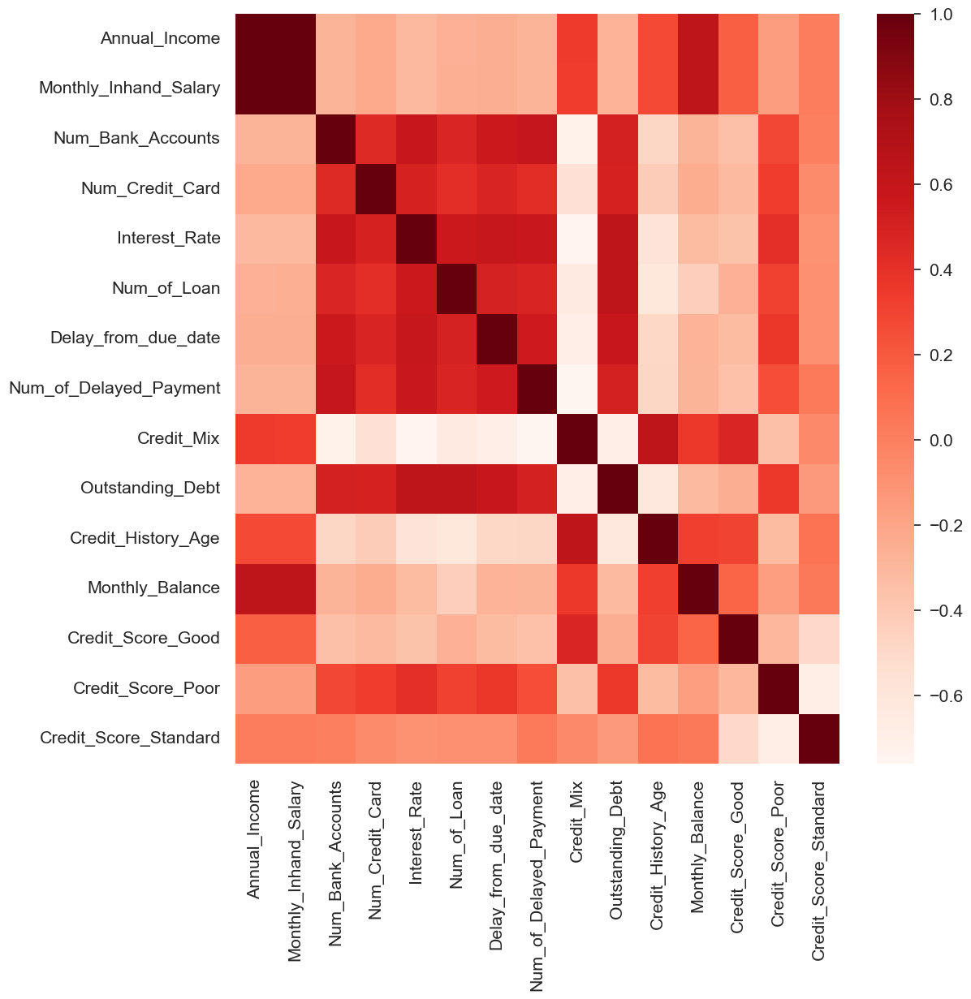

In [44]:
plt.figure(figsize=(12,12))
sns.set(font_scale = 1.4)
sns.heatmap(x.corr(), cmap="Reds")
plt.show()

In [45]:
from sklearn.model_selection import train_test_split 

In [46]:
# Split the data into train and test

x_train, x_test, y_train, y_test = train_test_split(x,y, test_size = 0.2, stratify = y, random_state = 2)

In [47]:
print(x.shape, x_train.shape, x_test.shape)

(25000, 15) (20000, 15) (5000, 15)


In [48]:
from sklearn.naive_bayes import GaussianNB, MultinomialNB, BernoulliNB
from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.naive_bayes import MultinomialNB
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import AdaBoostClassifier
from sklearn.ensemble import BaggingClassifier
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.ensemble import GradientBoostingClassifier
from xgboost import XGBClassifier
from sklearn.metrics import accuracy_score,confusion_matrix,precision_score 

In [49]:
# Model Training

gnb = GaussianNB()
mnb = MultinomialNB()
bnb = BernoulliNB()
svc = SVC(kernel = 'sigmoid', gamma = 1.0)
knc = KNeighborsClassifier()
dtc = DecisionTreeClassifier(max_depth = 5)
lrc = LogisticRegression(solver = 'liblinear', penalty = 'l1')
rfc = RandomForestClassifier(n_estimators = 50, random_state = 2)
abc = AdaBoostClassifier(n_estimators = 50, random_state = 2)
bc = BaggingClassifier(n_estimators = 50, random_state = 2)
etc = ExtraTreesClassifier(n_estimators = 50, random_state = 2)
gbdt = GradientBoostingClassifier(n_estimators = 50, random_state = 2)
xgb = XGBClassifier(n_estimators = 50, random_state = 2)

In [50]:
clfs = {
    'Support Vector Classification' : svc,
    'KNeighbors Classifier' : knc,
    'Gaussian Naive Bayes' : gnb,
    'Multinomial Naive Bayes': mnb, 
    'Bernoulli Naive Bayes' : bnb,
    'Decision Tree Classifier': dtc, 
    'Logistic Regression': lrc, 
    'Random Forest Classifier': rfc, 
    'AdaBoost Classifier': abc, 
    'Bagging Classifier': bc, 
    'Extra Trees Classifier': etc,
    'Gradient Boosting Classifier': gbdt,
    'XGB Classifier': xgb
}

In [51]:
def train_classifier(clf, x_train, y_train, x_test, y_test):
    clf.fit(x_train, y_train)
    y_pred = clf.predict(x_test)
    accuracy = accuracy_score(y_test, y_pred)
    
    return accuracy

In [52]:
%%time

train_classifier(svc, x_train, y_train, x_test, y_test)

C:\Users\lenovo\anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().



Wall time: 36.4 s


0.5016

In [53]:
%%time

accuracy_scores = []

for name, clf in clfs.items():
    
    accuracy = train_classifier(clf, x_train, y_train, x_test, y_test)
    
    print("For ", name)
    print("Accuracy - ", accuracy)

    accuracy_scores.append(accuracy)

C:\Users\lenovo\anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().



For  Support Vector Classification
Accuracy -  0.5016


C:\Users\lenovo\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:198: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().

C:\Users\lenovo\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning:

Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.



For  KNeighbors Classifier
Accuracy -  0.4904
For  Gaussian Naive Bayes
Accuracy -  0.505
For  Multinomial Naive Bayes
Accuracy -  0.5028
For  Bernoulli Naive Bayes
Accuracy -  0.4986


C:\Users\lenovo\anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().

C:\Users\lenovo\anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().

C:\Users\lenovo\anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().



For  Decision Tree Classifier
Accuracy -  0.4842


C:\Users\lenovo\anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().

C:\Users\lenovo\anaconda3\lib\site-packages\sklearn\svm\_base.py:1206: ConvergenceWarning:

Liblinear failed to converge, increase the number of iterations.

C:\Users\lenovo\AppData\Local\Temp\ipykernel_45084\2342298805.py:2: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().



For  Logistic Regression
Accuracy -  0.501
For  Random Forest Classifier
Accuracy -  0.4862


C:\Users\lenovo\anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().



For  AdaBoost Classifier
Accuracy -  0.4858


C:\Users\lenovo\anaconda3\lib\site-packages\sklearn\ensemble\_bagging.py:719: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().



For  Bagging Classifier
Accuracy -  0.4878


C:\Users\lenovo\AppData\Local\Temp\ipykernel_45084\2342298805.py:2: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().



For  Extra Trees Classifier
Accuracy -  0.4964


C:\Users\lenovo\anaconda3\lib\site-packages\sklearn\ensemble\_gb.py:494: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().



For  Gradient Boosting Classifier
Accuracy -  0.5002
For  XGB Classifier
Accuracy -  0.4892
Wall time: 1min 20s


In [54]:
performance_df = pd.DataFrame({'Algorithm':clfs.keys(),'Accuracy':accuracy_scores}).sort_values('Accuracy',ascending=False)
performance_df

,Algorithm,Accuracy
2,Gaussian Naive Bayes,0.5050
3,Multinomial Naive Bayes,0.5028
0,Support Vector Classification,0.5016
6,Logistic Regression,0.5010
11,Gradient Boosting Classifier,0.5002
4,Bernoulli Naive Bayes,0.4986
10,Extra Trees Classifier,0.4964
1,KNeighbors Classifier,0.4904
12,XGB Classifier,0.4892
9,Bagging Classifier,0.4878


### Data Preprocessing (step to handle imbalanced datasets)

--- SMOTEENN (UpSampling + ENN) 
It combines two methods: SMOTE for oversampling the minority class and ENN for cleaning the dataset by removing potentially noisy instances.

In [56]:
! pip install imbalanced-learn

     -------------------------------------- 235.6/235.6 kB 2.1 MB/s eta 0:00:00
     -------------------------------------- 302.2/302.2 kB 4.7 MB/s eta 0:00:00
  Attempting uninstall: joblib
    Found existing installation: joblib 1.1.0
    Uninstalling joblib-1.1.0:
      Successfully uninstalled joblib-1.1.0


In [57]:
from imblearn.combine import SMOTEENN

In [64]:
X_resampled

,Annual_Income,Monthly_Inhand_Salary,Num_Bank_Accounts,Num_Credit_Card,Interest_Rate,Num_of_Loan,Delay_from_due_date,Num_of_Delayed_Payment,Credit_Mix,Outstanding_Debt,Credit_History_Age,Monthly_Balance,Credit_Score_Good,Credit_Score_Poor,Credit_Score_Standard
0,7588.460000,663.371667,9,9,29,5,16,19,0,3948.860000,90,240.562821,0,1,0
1,121277.000000,9884.416667,4,1,7,4,8,10,2,867.240000,316,87.562023,1,0,0
2,19657.560000,1349.130000,4,3,15,2,26,10,1,1480.880000,73,296.005190,0,0,1
3,30874.430000,2595.869167,4,5,8,2,10,2,2,243.110000,262,363.005815,0,1,0
4,144468.720000,11788.060000,3,3,7,3,1,10,2,539.740000,252,929.365060,1,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3000,31720.515149,2691.047707,2,5,5,3,5,3,2,1245.777676,283,339.337944,0,0,0
3001,36380.004940,2938.912282,4,6,4,0,9,11,2,244.443576,223,300.927636,0,0,0
3002,92537.830944,7916.357600,1,3,3,0,3,5,2,425.750010,350,557.677058,0,0,1
3003,69278.777677,5980.466628,4,3,10,1,18,9,1,265.977576,282,618.928747,0,0,1


In [61]:
sm = SMOTEENN()
X_resampled, y_resampled = sm.fit_resample(x,y)

In [67]:
# Split the data into train and test

xr_train, xr_test, yr_train, yr_test = train_test_split(X_resampled, y_resampled, test_size = 0.2, stratify = y_resampled, random_state = 2)

In [68]:
print(X_resampled.shape, xr_train.shape, xr_test.shape)

(3005, 15) (2404, 15) (601, 15)


In [69]:
def train_classifier(clf, xr_train, yr_train, xr_test, yr_test):
    clf.fit(xr_train, yr_train)
    yr_pred = clf.predict(xr_test)
    resampled_accuracy = accuracy_score(yr_test, yr_pred)
    
    return resampled_accuracy

In [70]:
%%time

train_classifier(svc, xr_train, yr_train, xr_test, yr_test)

C:\Users\lenovo\anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().



Wall time: 538 ms


0.49916805324459235

In [71]:
%%time

resampled_accuracy_scores = []

for name, clf in clfs.items():
    
    accuracy = train_classifier(clf, xr_train, yr_train, xr_test, yr_test)
    
    print("For ", name)
    print("Accuracy - ", accuracy)

    resampled_accuracy_scores.append(accuracy)

C:\Users\lenovo\anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().



For  Support Vector Classification
Accuracy -  0.49916805324459235
For  KNeighbors Classifier
Accuracy -  0.7720465890183028
For  Gaussian Naive Bayes
Accuracy -  0.4925124792013311
For  Multinomial Naive Bayes
Accuracy -  0.540765391014975
For  Bernoulli Naive Bayes
Accuracy -  0.4925124792013311
For  Decision Tree Classifier
Accuracy -  0.5341098169717138


C:\Users\lenovo\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:198: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().

C:\Users\lenovo\anaconda3\lib\site-packages\sklearn\neighbors\_classification.py:228: FutureWarning:

Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.

C:\Users\lenovo\anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().

C:\Users\lenovo\anacon

For  Logistic Regression
Accuracy -  0.5108153078202995
For  Random Forest Classifier
Accuracy -  0.8352745424292846


C:\Users\lenovo\anaconda3\lib\site-packages\sklearn\utils\validation.py:993: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().



For  AdaBoost Classifier
Accuracy -  0.589018302828619


C:\Users\lenovo\anaconda3\lib\site-packages\sklearn\ensemble\_bagging.py:719: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().



For  Bagging Classifier
Accuracy -  0.8519134775374376


C:\Users\lenovo\AppData\Local\Temp\ipykernel_45084\770111877.py:2: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().



For  Extra Trees Classifier
Accuracy -  0.7853577371048253


C:\Users\lenovo\anaconda3\lib\site-packages\sklearn\ensemble\_gb.py:494: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().



For  Gradient Boosting Classifier
Accuracy -  0.653910149750416
For  XGB Classifier
Accuracy -  0.7903494176372712
Wall time: 5.22 s


In [73]:
resampled_performance_df = pd.DataFrame({'Algorithm':clfs.keys(),'Accuracy':resampled_accuracy_scores}).sort_values('Accuracy',ascending=False)
resampled_performance_df

,Algorithm,Accuracy
9,Bagging Classifier,0.851913
7,Random Forest Classifier,0.835275
12,XGB Classifier,0.790349
10,Extra Trees Classifier,0.785358
1,KNeighbors Classifier,0.772047
11,Gradient Boosting Classifier,0.653910
8,AdaBoost Classifier,0.589018
3,Multinomial Naive Bayes,0.540765
5,Decision Tree Classifier,0.534110
6,Logistic Regression,0.510815


### Model Building

In [74]:
model = BaggingClassifier()
model.fit(xr_train, yr_train)

C:\Users\lenovo\anaconda3\lib\site-packages\sklearn\ensemble\_bagging.py:719: DataConversionWarning:

A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().



BaggingClassifier()

In [78]:
print("Credit Score Prediction : ")
a = float(input("Annual Income: "))
b = float(input("Monthly Inhand Salary: "))
c = float(input("Number of Bank Accounts: "))
d = float(input("Number of Credit Cards: "))
e = float(input("Interest Rate: "))
f = float(input("Number of Loans: "))
g = float(input("Average number of days delayed by the person: "))
h = float(input("Number of delayed payments: "))
i = input("Credit Mix (Bad: 0, Standard: 1, Good: 3) : ")
j = float(input("Outstanding Debt: "))
k = float(input("Credit History Age: "))
l = float(input("Monthly Balance: "))
m = int(input("Credit Score Good: "))
n = int(input("Credit Score Poor: "))
o = int(input("Credit Score Standard: "))

features = np.array([[a, b, c, d, e, f, g, h, i, j, k, l, m, n, o]])
print("Predicted Attrition = ", model.predict(features))

Credit Score Prediction : 
Annual Income: 7588.460000
Monthly Inhand Salary: 663.371667
Number of Bank Accounts: 9
Number of Credit Cards: 9
Interest Rate: 29
Number of Loans: 5
Average number of days delayed by the person: 16
Number of delayed payments: 19
Credit Mix (Bad: 0, Standard: 1, Good: 3) : 0
Outstanding Debt: 3948.860000
Credit History Age: 90
Monthly Balance: 240.562821
Credit Score Good: 0
Credit Score Poor: 1
Credit Score Standard: 0
Predicted Attrition =  [0]


C:\Users\lenovo\anaconda3\lib\site-packages\sklearn\base.py:450: UserWarning:

X does not have valid feature names, but BaggingClassifier was fitted with feature names

